# Image Enhancement with BSRGAN and ESRGAN

## Install Required Libraries

In [1]:
# Install required packages
!pip install opencv-python matplotlib numpy torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 108.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 68.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 42.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 102.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvji

## Mount Google Drive and Setup

In [12]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive', force_remount=True)

# Set up directories
# CHANGE THIS PATH to your input directory in Google Drive
drive_input_dir = '/content/drive/MyDrive/gan_images_text'

# Output directory in Google Drive for enhanced images
drive_output_dir = '/content/drive/MyDrive/gan_output_images'

# Local directories for processing
local_input_dir = '/content/input_images'
local_output_dir = '/content/output_images'

# Create all directories
os.makedirs(drive_output_dir, exist_ok=True)
os.makedirs(local_input_dir, exist_ok=True)
os.makedirs(local_output_dir, exist_ok=True)

Mounted at /content/drive


## Download BSRGAN Model

In [13]:
# Create models directory
!mkdir -p /content/models

# Download pre-trained BSRGAN model
!wget -nc https://github.com/cszn/KAIR/releases/download/v1.0/BSRGAN.pth -P /content/models/

File ‘/content/models/BSRGAN.pth’ already there; not retrieving.



In [14]:
!gdown --id 1TPrz5QKd8DHHt1k8SRtm6tMiPjz_Qene -O /content/models/RRDB_ESRGAN_x4.pth


/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1TPrz5QKd8DHHt1k8SRtm6tMiPjz_Qene
To: /content/models/RRDB_ESRGAN_x4.pth
100% 66.9M/66.9M [00:00<00:00, 212MB/s]


## Copy Images from Google Drive

In [15]:
# Copy images from Google Drive to local directory
def copy_images_from_drive():
    # Check if the input directory exists
    if not os.path.exists(drive_input_dir):
        print(f"Error: The directory {drive_input_dir} does not exist in your Google Drive.")
        return []

    # Get list of image files
    image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')
    image_files = [f for f in os.listdir(drive_input_dir)
                  if os.path.isfile(os.path.join(drive_input_dir, f)) and
                  f.lower().endswith(image_extensions)]

    if not image_files:
        print(f"No image files found in {drive_input_dir}")
        return []

    print(f"Found {len(image_files)} images in {drive_input_dir}")
    print("Copying images to local directory...")

    # Copy each image to local directory
    for filename in image_files:
        src_path = os.path.join(drive_input_dir, filename)
        dst_path = os.path.join(local_input_dir, filename)
        !cp "{src_path}" "{dst_path}"
        print(f"Copied {filename}")

    print(f"Successfully copied {len(image_files)} images to {local_input_dir}")
    return image_files

# Execute the function
image_files = copy_images_from_drive()

Found 3 images in /content/drive/MyDrive/gan_images_text
Copying images to local directory...
Copied 6.jpg
Copied 8.jpg
Copied 5.jpg
Successfully copied 3 images to /content/input_images


## Define RRDB Model Architecture

In [16]:
# Define the model architecture
class ResidualDenseBlock(nn.Module):
    def __init__(self, nf=64, gc=32, bias=True):
        super(ResidualDenseBlock, self).__init__()
        # gc: growth channel, i.e. intermediate channels
        self.conv1 = nn.Conv2d(nf, gc, 3, 1, 1, bias=bias)
        self.conv2 = nn.Conv2d(nf + gc, gc, 3, 1, 1, bias=bias)
        self.conv3 = nn.Conv2d(nf + 2 * gc, gc, 3, 1, 1, bias=bias)
        self.conv4 = nn.Conv2d(nf + 3 * gc, gc, 3, 1, 1, bias=bias)
        self.conv5 = nn.Conv2d(nf + 4 * gc, nf, 3, 1, 1, bias=bias)
        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)
        # initialization
        # mutil.initialize_weights([self.conv1, self.conv2, self.conv3, self.conv4, self.conv5], 0.1)

    def forward(self, x):
        x1 = self.lrelu(self.conv1(x))
        x2 = self.lrelu(self.conv2(torch.cat((x, x1), 1)))
        x3 = self.lrelu(self.conv3(torch.cat((x, x1, x2), 1)))
        x4 = self.lrelu(self.conv4(torch.cat((x, x1, x2, x3), 1)))
        x5 = self.conv5(torch.cat((x, x1, x2, x3, x4), 1))
        return x5 * 0.2 + x


class RRDB(nn.Module):
    '''Residual in Residual Dense Block'''
    def __init__(self, nf, gc=32):
        super(RRDB, self).__init__()
        self.RDB1 = ResidualDenseBlock(nf, gc)
        self.RDB2 = ResidualDenseBlock(nf, gc)
        self.RDB3 = ResidualDenseBlock(nf, gc)

    def forward(self, x):
        out = self.RDB1(x)
        out = self.RDB2(out)
        out = self.RDB3(out)
        return out * 0.2 + x


class RRDBNet(nn.Module):
    def __init__(self, in_nc=3, out_nc=3, nf=64, nb=23, gc=32, scale=4, upscale=False):
        super(RRDBNet, self).__init__()
        self.scale = scale
        RRDB_block_f = lambda nf: RRDB(nf, gc=gc)

        self.conv_first = nn.Conv2d(in_nc, nf, 3, 1, 1, bias=True)
        self.RRDB_trunk = self.make_layer(RRDB_block_f, nf, nb)
        self.trunk_conv = nn.Conv2d(nf, nf, 3, 1, 1, bias=True)

        # Upsampling layers
        self.upscale = upscale
        if self.upscale:
            self.upconv1 = nn.Conv2d(nf, nf, 3, 1, 1, bias=True)
            self.upconv2 = nn.Conv2d(nf, nf, 3, 1, 1, bias=True)
            self.HRconv = nn.Conv2d(nf, nf, 3, 1, 1, bias=True)
            self.conv_last = nn.Conv2d(nf, out_nc, 3, 1, 1, bias=True)
            self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)

    def make_layer(self, block, nf, n_layers):
        layers = []
        for _ in range(n_layers):
            layers.append(block(nf))
        return nn.Sequential(*layers)

    def forward(self, x):
        fea = self.conv_first(x)
        trunk = self.RRDB_trunk(fea)
        trunk = self.trunk_conv(trunk)
        fea = fea + trunk

        if self.upscale:
            # Upsampling
            fea = self.lrelu(self.upconv1(F.interpolate(fea, scale_factor=2, mode='nearest')))
            fea = self.lrelu(self.upconv2(F.interpolate(fea, scale_factor=2, mode='nearest')))
            out = self.conv_last(self.lrelu(self.HRconv(fea)))
        else:
            # No upsampling, just apply a final convolution
            out = fea

        return out

## Metrics Functions

In [17]:
import numpy as np
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from scipy.ndimage import gaussian_filter

def calculate_metrics(original_img, enhanced_img):
    """Calculate image quality metrics

    Args:
        original_img: Original image (numpy array, RGB)
        enhanced_img: Enhanced image (numpy array, RGB)

    Returns:
        metrics: Dictionary of metrics
    """
    # Resize enhanced image to match original if needed
    if original_img.shape != enhanced_img.shape:
        enhanced_img = cv2.resize(enhanced_img, (original_img.shape[1], original_img.shape[0]),
                                 interpolation=cv2.INTER_CUBIC)

    # Convert to Y channel (luminance) for more accurate metrics
    def rgb_to_y(img):
        return 0.299 * img[:,:,0] + 0.587 * img[:,:,1] + 0.114 * img[:,:,2]

    original_y = rgb_to_y(original_img)
    enhanced_y = rgb_to_y(enhanced_img)

    # Calculate PSNR
    psnr = peak_signal_noise_ratio(original_y, enhanced_y, data_range=255)

    # Calculate SSIM
    ssim = structural_similarity(original_y, enhanced_y, data_range=255)

    # Calculate sharpness (variance of Laplacian)
    def calculate_sharpness(img):
        gray = img if len(img.shape) == 2 else rgb_to_y(img)
        return cv2.Laplacian(gray.astype(np.uint8), cv2.CV_64F).var()

    original_sharpness = calculate_sharpness(original_img)
    enhanced_sharpness = calculate_sharpness(enhanced_img)
    sharpness_increase = (enhanced_sharpness - original_sharpness) / original_sharpness * 100

    # Calculate detail retention (high-frequency content)
    def calculate_details(img):
        gray = img if len(img.shape) == 2 else rgb_to_y(img)
        # Apply Gaussian blur
        blurred = gaussian_filter(gray, sigma=3)
        # Calculate high-frequency content
        high_freq = np.abs(gray - blurred)
        return np.mean(high_freq)

    original_details = calculate_details(original_img)
    enhanced_details = calculate_details(enhanced_img)
    detail_increase = (enhanced_details - original_details) / original_details * 100

    metrics = {
        'psnr': psnr,
        'ssim': ssim,
        'original_sharpness': original_sharpness,
        'enhanced_sharpness': enhanced_sharpness,
        'sharpness_increase': sharpness_increase,
        'original_details': original_details,
        'enhanced_details': enhanced_details,
        'detail_increase': detail_increase
    }

    return metrics

## Initialize Models

In [18]:
def load_model(model_path, model_type='bsrgan'):
    """Load the BSRGAN or ESRGAN model

    Args:
        model_path: Path to the pre-trained model
        model_type: 'bsrgan' or 'esrgan'

    Returns:
        model: Loaded model
    """
    # Set device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Create model
    if model_type == 'bsrgan':
        model = RRDBNet(in_nc=3, out_nc=3, nf=64, nb=23, gc=32, scale=4, upscale=True)
        print("Loading BSRGAN model...")
    else:  # esrgan
        model = RRDBNet(in_nc=3, out_nc=3, nf=64, nb=23, gc=32, scale=4, upscale=True)
        print("Loading ESRGAN model...")

    # Load state dictionary
    state_dict = torch.load(model_path, map_location=device)

    # Handle different state dict formats
    if 'params_ema' in state_dict:
        model.load_state_dict(state_dict['params_ema'], strict=True)
    elif 'params' in state_dict:
        model.load_state_dict(state_dict['params'], strict=True)
    else:
        model.load_state_dict(state_dict, strict=True)

    model.eval()
    model = model.to(device)

    return model, device

# Load BSRGAN model
bsrgan_model, device = load_model('/content/models/BSRGAN.pth', model_type='bsrgan')

# Load ESRGAN model
esrgan_model, _ = load_model('/content/models/RRDB_ESRGAN_x4.pth', model_type='esrgan')

Using device: cuda
Loading BSRGAN model...
Using device: cuda
Loading ESRGAN model...


## Process Images

In [19]:
def process_image(img_path, output_path, model, device, tile_size=None):
    """Process a single image with the model

    Args:
        img_path: Path to input image
        output_path: Path to save output image
        model: Neural network model
        device: torch.device
        tile_size: Size for tiled processing (None for no tiling)
    """
    # Read image
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    if img is None:
        print(f"Error: Could not read image {img_path}")
        return None, None

    # Prepare input
    img = img.astype(np.float32) / 255.
    img = torch.from_numpy(np.transpose(img, (2, 0, 1))).unsqueeze(0).to(device)

    # Get original image dimensions
    _, _, h_old, w_old = img.size()

    # Process image
    with torch.no_grad():
        # Use tiled processing for large images to avoid out-of-memory
        if tile_size is not None and (h_old > tile_size or w_old > tile_size):
            # Process large image in tiles
            print(f"Processing large image in tiles of size {tile_size}")
            scale = 4  # upscale factor
            tile = tile_size
            tile_overlap = 32  # overlap between tiles
            stride = tile - tile_overlap

            # Initialize output tensor
            output = torch.zeros(1, 3, h_old*scale, w_old*scale, device=device)
            weight = torch.zeros_like(output)

            # Process each tile
            for h_idx in range(0, h_old, stride):
                for w_idx in range(0, w_old, stride):
                    # Handle boundary cases
                    h_end = min(h_idx + tile, h_old)
                    w_end = min(w_idx + tile, w_old)
                    h_start = max(0, h_end - tile)
                    w_start = max(0, w_end - tile)

                    # Extract tile
                    in_patch = img[:, :, h_start:h_end, w_start:w_end]

                    # Process tile
                    out_patch = model(in_patch)

                    # Get output coordinates
                    out_h_start = h_start * scale
                    out_w_start = w_start * scale
                    out_h_end = h_end * scale
                    out_w_end = w_end * scale

                    # Apply weight mask for smooth blending
                    weight_patch = torch.ones_like(out_patch)
                    output[:, :, out_h_start:out_h_end, out_w_start:out_w_end] += out_patch
                    weight[:, :, out_h_start:out_h_end, out_w_start:out_w_end] += weight_patch

            # Average overlapping regions
            output = output / weight
        else:
            # Process entire image at once
            output = model(img)

    # Save output image
    output = output.data.squeeze().float().cpu().clamp_(0, 1).numpy()
    output = np.transpose(output, (1, 2, 0))
    output = (output * 255.0).round().astype(np.uint8)
    cv2.imwrite(output_path, output)

    # Prepare images for display
    input_img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    input_img_rgb = cv2.cvtColor(input_img, cv2.COLOR_BGR2RGB)
    output_img_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

    # Calculate metrics
    metrics = calculate_metrics(input_img_rgb, output_img_rgb)

    # Print metrics
    print("\nImage Quality Metrics:")
    print(f"PSNR: {metrics['psnr']:.2f} dB")
    print(f"SSIM: {metrics['ssim']:.4f}")
    print(f"Sharpness increase: {metrics['sharpness_increase']:.2f}%")
    print(f"Detail increase: {metrics['detail_increase']:.2f}%")

    return input_img_rgb, output_img_rgb, metrics

In [20]:
# Process all images with BSRGAN
def process_all_images(image_files, model, device, model_name="BSRGAN", tile_size=None):
    """Process all images with the model

    Args:
        image_files: List of image filenames
        model: Neural network model
        device: torch.device
        model_name: Name of the model for output filename
        tile_size: Size for tiled processing (None for no tiling)
    """
    for filename in image_files:
        input_path = os.path.join(local_input_dir, filename)
        output_filename = os.path.splitext(filename)[0] + f'_{model_name}.png'
        output_path = os.path.join(local_output_dir, output_filename)

        print(f"Processing {filename} with {model_name}...")

        try:
            # Process image - capture the metrics
            input_img_rgb, output_img_rgb, metrics = process_image(
                input_path, output_path, model, device, tile_size
            )


            if input_img_rgb is None or output_img_rgb is None:
                print(f"Error processing {filename}")
                continue

            # Copy to Google Drive
            drive_output_path = os.path.join(drive_output_dir, output_filename)
            !cp "{output_path}" "{drive_output_path}"
            print(f"Saved to Google Drive: {drive_output_path}")

            # Display before/after comparison
            plt.figure(figsize=(20, 10))

            # Original image
            plt.subplot(1, 2, 1)
            plt.imshow(input_img_rgb)
            plt.title(f"Original: {filename}")
            plt.axis('off')

            # Enhanced image
            plt.subplot(1, 2, 2)
            plt.imshow(output_img_rgb)
            plt.title(f"Enhanced ({model_name}): {output_filename}\nPSNR: {metrics['psnr']:.2f} dB, SSIM: {metrics['ssim']:.4f}\nSharpness: +{metrics['sharpness_increase']:.2f}%")
            plt.axis('off')

            plt.tight_layout()
            plt.show()

        except Exception as e:
            print(f"Error processing {filename}: {e}")

    print(f"Processing with {model_name} complete!")

Processing 6.jpg with BSRGAN...
Processing large image in tiles of size 512

Image Quality Metrics:
PSNR: 29.14 dB
SSIM: 0.5046
Sharpness increase: 30.47%
Detail increase: -54.72%
Saved to Google Drive: /content/drive/MyDrive/gan_output_images/6_BSRGAN.png


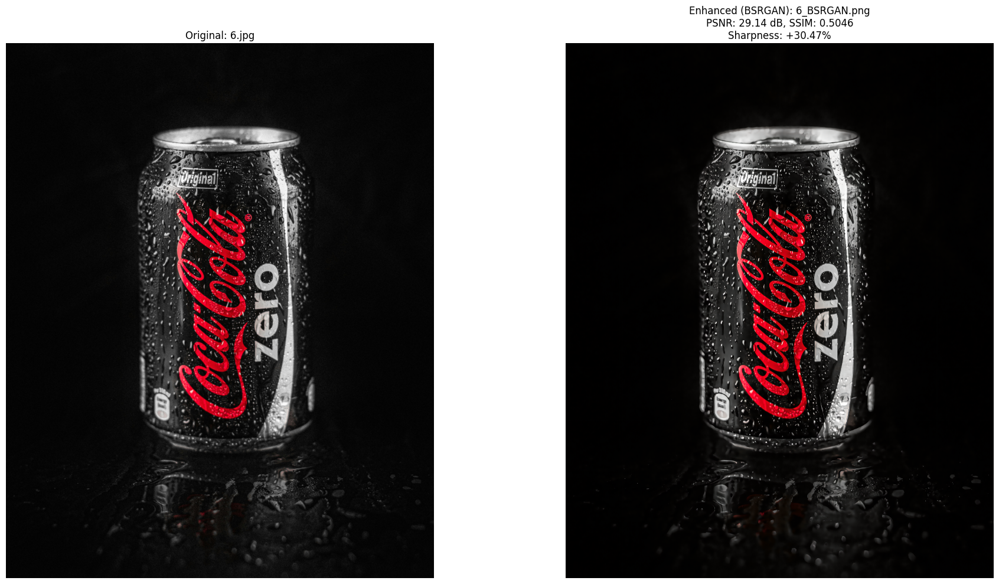

Processing 8.jpg with BSRGAN...
Processing large image in tiles of size 512

Image Quality Metrics:
PSNR: 33.87 dB
SSIM: 0.5438
Sharpness increase: 244.15%
Detail increase: -46.58%
Saved to Google Drive: /content/drive/MyDrive/gan_output_images/8_BSRGAN.png


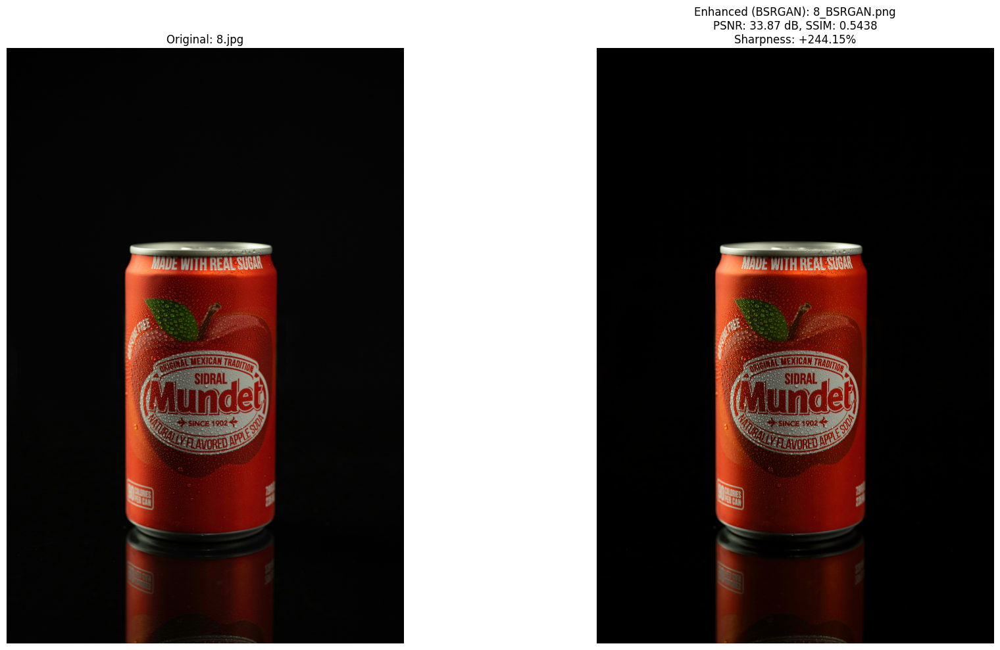

Processing 5.jpg with BSRGAN...
Processing large image in tiles of size 512

Image Quality Metrics:
PSNR: 36.75 dB
SSIM: 0.9477
Sharpness increase: 107.76%
Detail increase: -15.18%
Saved to Google Drive: /content/drive/MyDrive/gan_output_images/5_BSRGAN.png


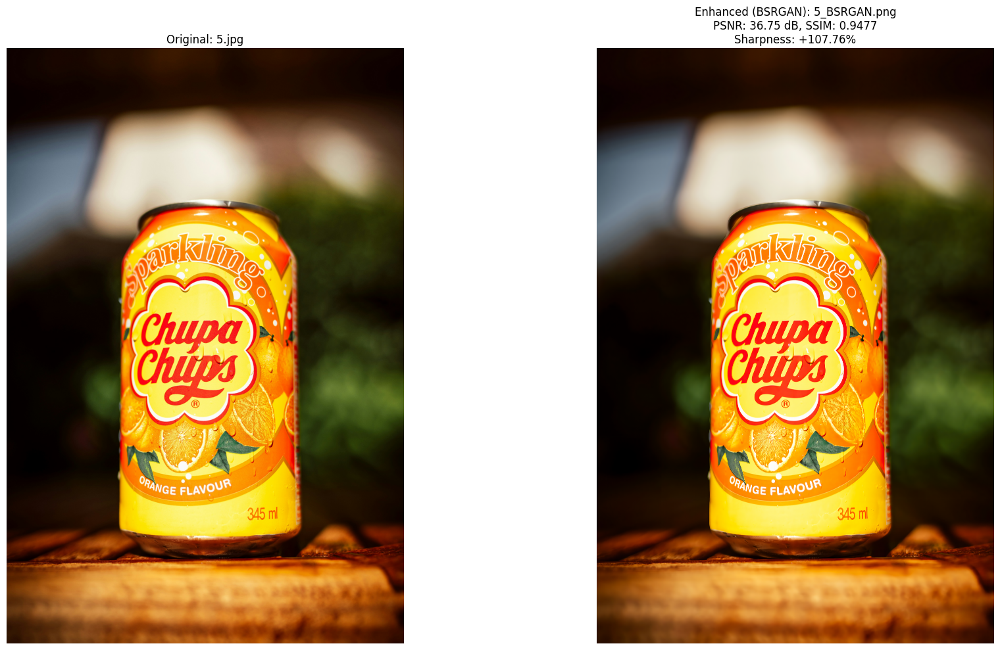

Processing with BSRGAN complete!


In [21]:
# Process all images with BSRGAN
# Use tile_size=512 for large images if you run out of memory
process_all_images(image_files, bsrgan_model, device, model_name="BSRGAN", tile_size=512)

Processing 6.jpg with ESRGAN...
Processing large image in tiles of size 512

Image Quality Metrics:
PSNR: 41.81 dB
SSIM: 0.9872
Sharpness increase: 75.56%
Detail increase: 3.16%
Saved to Google Drive: /content/drive/MyDrive/gan_output_images/6_ESRGAN.png


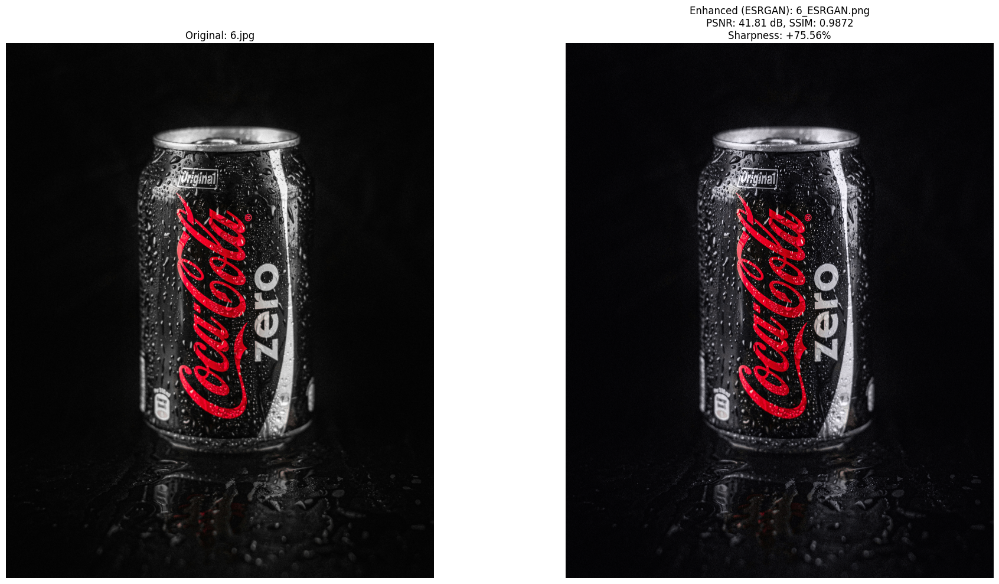

Processing 8.jpg with ESRGAN...
Processing large image in tiles of size 512

Image Quality Metrics:
PSNR: 44.77 dB
SSIM: 0.9852
Sharpness increase: 156.66%
Detail increase: 7.63%
Saved to Google Drive: /content/drive/MyDrive/gan_output_images/8_ESRGAN.png


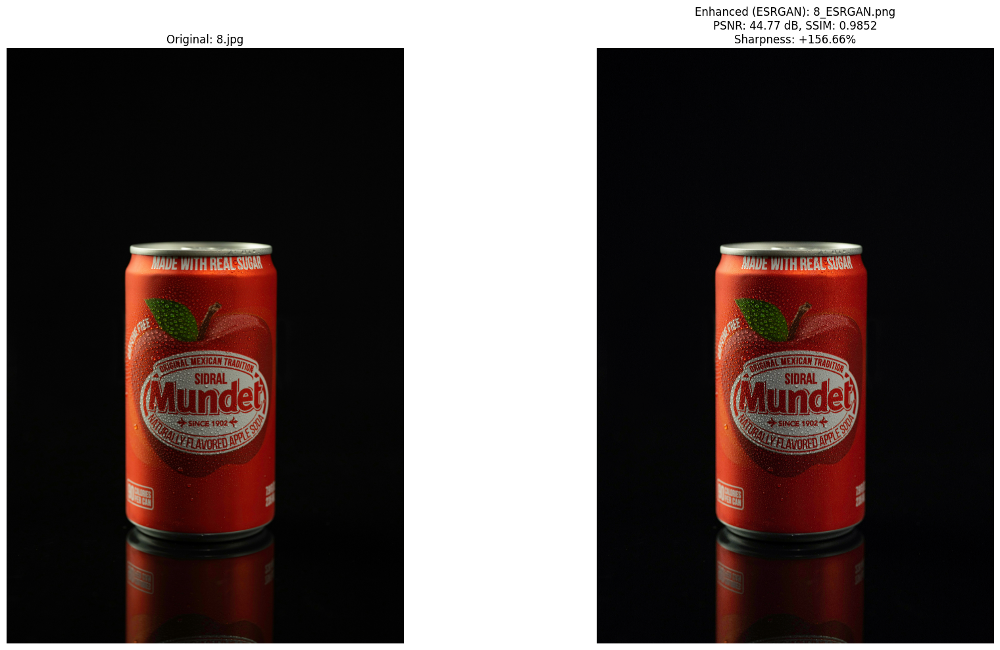

Processing 5.jpg with ESRGAN...
Processing large image in tiles of size 512

Image Quality Metrics:
PSNR: 45.40 dB
SSIM: 0.9935
Sharpness increase: 96.41%
Detail increase: 6.74%
Saved to Google Drive: /content/drive/MyDrive/gan_output_images/5_ESRGAN.png


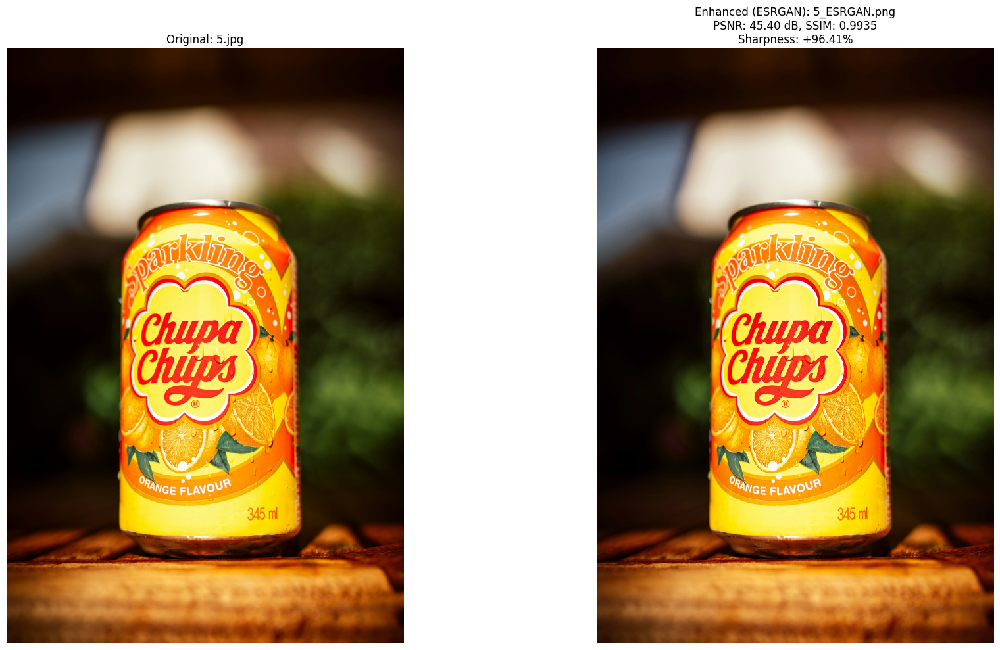

Processing with ESRGAN complete!


In [22]:
# Process all images with ESRGAN
# Use tile_size=512 for large images if you run out of memory
process_all_images(image_files, esrgan_model, device, model_name="ESRGAN", tile_size=512)

## Compare Metrics for different models


Metrics Comparison for 6.jpg:
Metric               BSRGAN          ESRGAN         
--------------------------------------------------
PSNR (dB)            29.14           41.81          
SSIM                 0.5046          0.9872         
Sharpness Increase   30.47          % 75.56          %
Detail Increase      -54.72         % 3.16           %


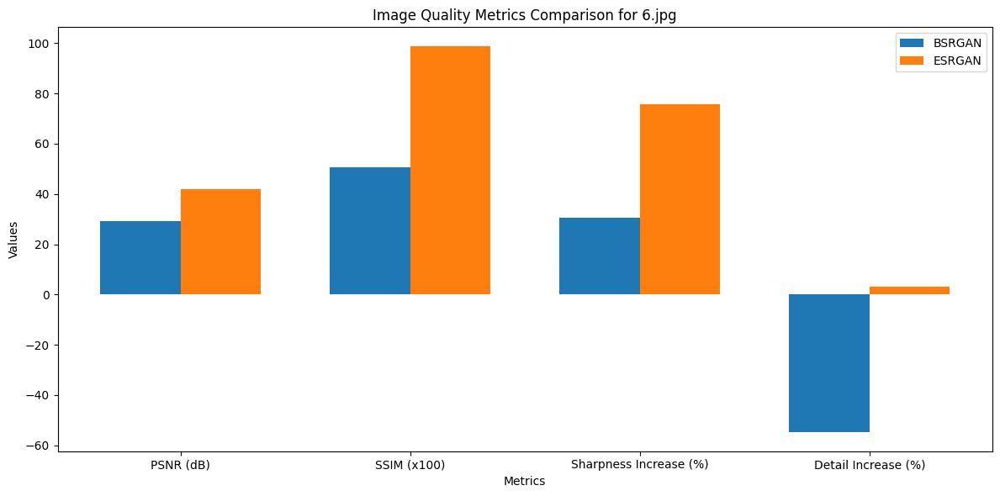


Metrics Comparison for 5.jpg:
Metric               BSRGAN          ESRGAN         
--------------------------------------------------
PSNR (dB)            36.75           45.40          
SSIM                 0.9477          0.9935         
Sharpness Increase   107.76         % 96.41          %
Detail Increase      -15.18         % 6.74           %


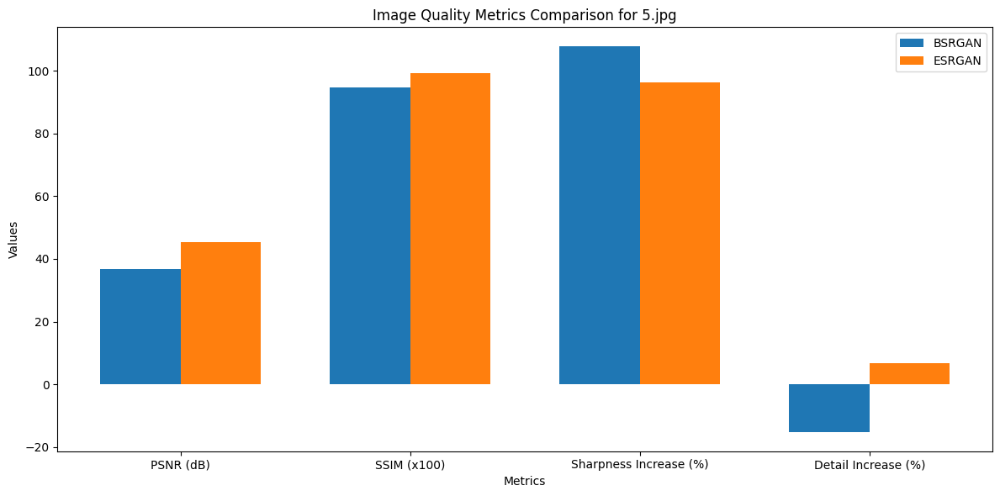

In [24]:
def compare_model_metrics(filename):
    """Compare metrics between BSRGAN and ESRGAN on a single image"""
    input_path = os.path.join(local_input_dir, filename)
    bsrgan_path = os.path.join(local_output_dir, os.path.splitext(filename)[0] + '_BSRGAN.png')
    esrgan_path = os.path.join(local_output_dir, os.path.splitext(filename)[0] + '_ESRGAN.png')

    # Read images
    img_orig = cv2.imread(input_path, cv2.IMREAD_COLOR)
    img_bsrgan = cv2.imread(bsrgan_path, cv2.IMREAD_COLOR)
    img_esrgan = cv2.imread(esrgan_path, cv2.IMREAD_COLOR)

    # Convert to RGB
    img_orig_rgb = cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB)
    img_bsrgan_rgb = cv2.cvtColor(img_bsrgan, cv2.COLOR_BGR2RGB)
    img_esrgan_rgb = cv2.cvtColor(img_esrgan, cv2.COLOR_BGR2RGB)

    # Calculate metrics
    bsrgan_metrics = calculate_metrics(img_orig_rgb, img_bsrgan_rgb)
    esrgan_metrics = calculate_metrics(img_orig_rgb, img_esrgan_rgb)

    # Print comparison
    print(f"\nMetrics Comparison for {filename}:")
    print(f"{'Metric':<20} {'BSRGAN':<15} {'ESRGAN':<15}")
    print("-" * 50)
    print(f"{'PSNR (dB)':<20} {bsrgan_metrics['psnr']:<15.2f} {esrgan_metrics['psnr']:<15.2f}")
    print(f"{'SSIM':<20} {bsrgan_metrics['ssim']:<15.4f} {esrgan_metrics['ssim']:<15.4f}")
    print(f"{'Sharpness Increase':<20} {bsrgan_metrics['sharpness_increase']:<15.2f}% {esrgan_metrics['sharpness_increase']:<15.2f}%")
    print(f"{'Detail Increase':<20} {bsrgan_metrics['detail_increase']:<15.2f}% {esrgan_metrics['detail_increase']:<15.2f}%")

    # Create bar chart for visual comparison
    metrics_to_plot = ['psnr', 'ssim', 'sharpness_increase', 'detail_increase']
    labels = ['PSNR (dB)', 'SSIM (x100)', 'Sharpness Increase (%)', 'Detail Increase (%)']

    bsrgan_values = [bsrgan_metrics['psnr'], bsrgan_metrics['ssim']*100,
                    bsrgan_metrics['sharpness_increase'], bsrgan_metrics['detail_increase']]
    esrgan_values = [esrgan_metrics['psnr'], esrgan_metrics['ssim']*100,
                    esrgan_metrics['sharpness_increase'], esrgan_metrics['detail_increase']]

    x = np.arange(len(metrics_to_plot))
    width = 0.35

    plt.figure(figsize=(12, 6))
    plt.bar(x - width/2, bsrgan_values, width, label='BSRGAN')
    plt.bar(x + width/2, esrgan_values, width, label='ESRGAN')

    plt.xlabel('Metrics')
    plt.ylabel('Values')
    plt.title(f'Image Quality Metrics Comparison for {filename}')
    plt.xticks(x, labels)
    plt.legend()

    plt.tight_layout()
    plt.show()

compare_model_metrics("6.jpg")
compare_model_metrics("5.jpg")


Metrics Comparison for 8.jpg:
Metric               BSRGAN          ESRGAN         
--------------------------------------------------
PSNR (dB)            33.87           44.77          
SSIM                 0.5438          0.9852         
Sharpness Increase   244.15         % 156.66         %
Detail Increase      -46.58         % 7.63           %


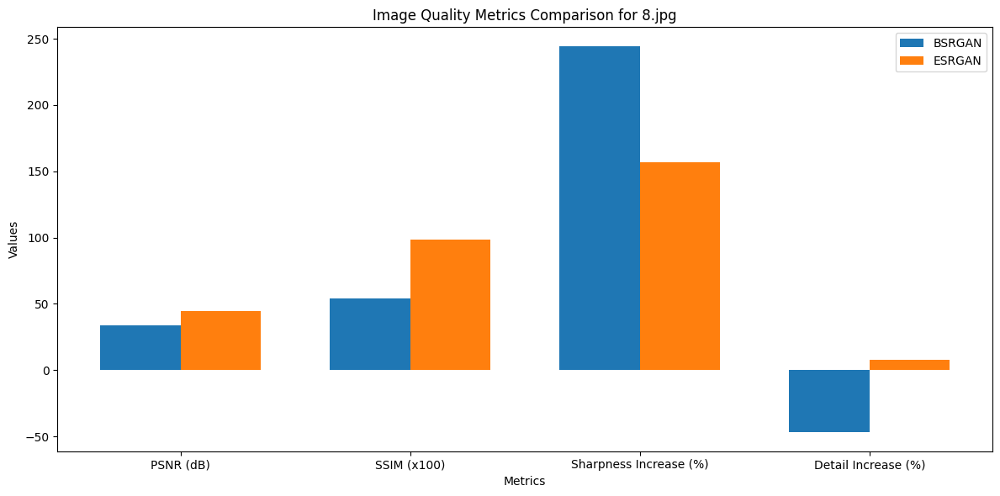

In [25]:
compare_model_metrics("8.jpg")

## Create Image Crops for Detailed Comparison

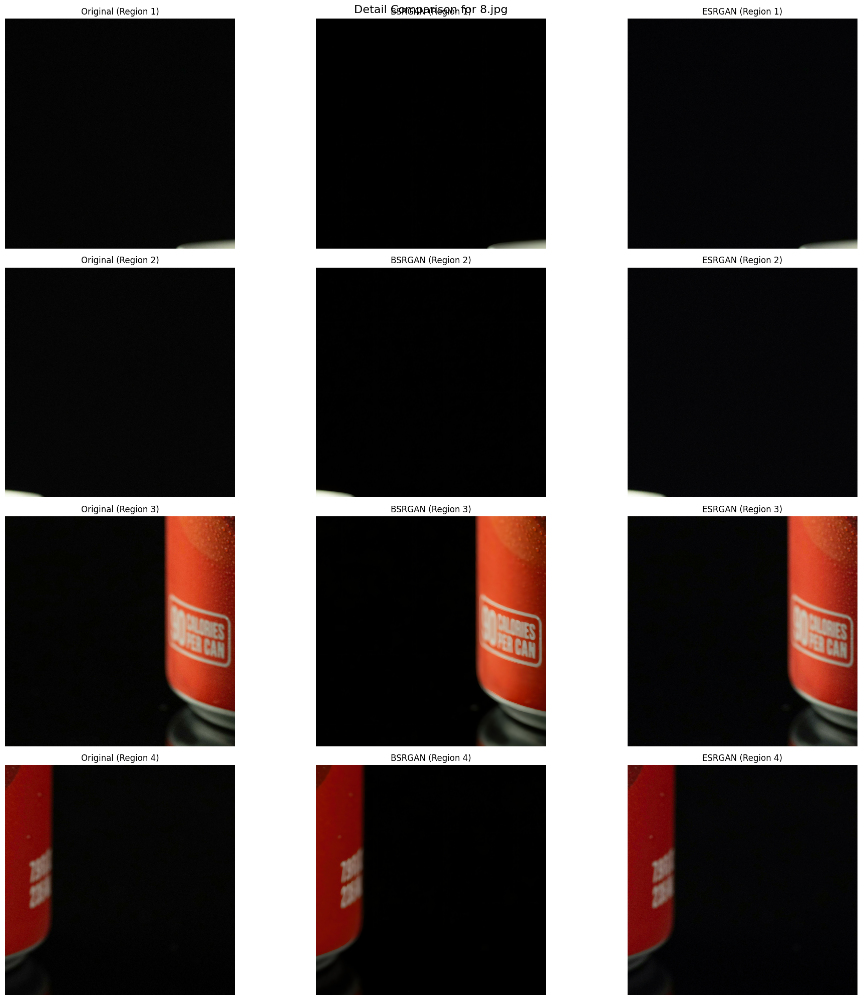

In [26]:
def compare_detail_crops(filename):
    """Compare detail crops from BSRGAN and ESRGAN enhanced images

    Args:
        filename: Image filename to process
    """
    # Paths
    input_path = os.path.join(local_input_dir, filename)
    bsrgan_path = os.path.join(local_output_dir, os.path.splitext(filename)[0] + '_BSRGAN.png')
    esrgan_path = os.path.join(local_output_dir, os.path.splitext(filename)[0] + '_ESRGAN.png')

    # Check if files exist
    if not all(os.path.exists(p) for p in [input_path, bsrgan_path, esrgan_path]):
        print("Error: One or more files not found. Run the comparison first.")
        return

    # Read images
    img_orig = cv2.imread(input_path)
    img_bsrgan = cv2.imread(bsrgan_path)
    img_esrgan = cv2.imread(esrgan_path)

    # Convert to RGB
    img_orig_rgb = cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB)
    img_bsrgan_rgb = cv2.cvtColor(img_bsrgan, cv2.COLOR_BGR2RGB)
    img_esrgan_rgb = cv2.cvtColor(img_esrgan, cv2.COLOR_BGR2RGB)

    # Get dimensions
    h, w = img_orig.shape[:2]
    h_enh, w_enh = img_bsrgan.shape[:2]
    scale = h_enh // h

    # Define crop regions (in original image coordinates)
    crop_size = min(h, w) // 4
    centers = [
        (h // 4, w // 4),          # Top-left region
        (h // 4, 3 * w // 4),      # Top-right region
        (3 * h // 4, w // 4),      # Bottom-left region
        (3 * h // 4, 3 * w // 4)   # Bottom-right region
    ]

    # Create figure for displaying crops
    plt.figure(figsize=(20, 20))

    # Display each crop region
    for i, (cy, cx) in enumerate(centers):
        # Calculate crop boundaries (with padding to avoid going out of bounds)
        y1 = max(0, cy - crop_size // 2)
        x1 = max(0, cx - crop_size // 2)
        y2 = min(h, cy + crop_size // 2)
        x2 = min(w, cx + crop_size // 2)

        # Calculate enhanced crop boundaries
        y1_enh = y1 * scale
        x1_enh = x1 * scale
        y2_enh = y2 * scale
        x2_enh = x2 * scale

        # Extract crops
        crop_orig = img_orig_rgb[y1:y2, x1:x2]
        crop_bsrgan = img_bsrgan_rgb[y1_enh:y2_enh, x1_enh:x2_enh]
        crop_esrgan = img_esrgan_rgb[y1_enh:y2_enh, x1_enh:x2_enh]

        # Display crops
        plt.subplot(4, 3, 3*i + 1)
        plt.imshow(crop_orig)
        plt.title(f"Original (Region {i+1})")
        plt.axis('off')

        plt.subplot(4, 3, 3*i + 2)
        plt.imshow(crop_bsrgan)
        plt.title(f"BSRGAN (Region {i+1})")
        plt.axis('off')

        plt.subplot(4, 3, 3*i + 3)
        plt.imshow(crop_esrgan)
        plt.title(f"ESRGAN (Region {i+1})")
        plt.axis('off')

    plt.tight_layout()
    plt.suptitle(f"Detail Comparison for {filename}", fontsize=16, y=0.995)
    plt.show()

# Example usage (uncomment and replace with your image filename)
compare_detail_crops("8.jpg")

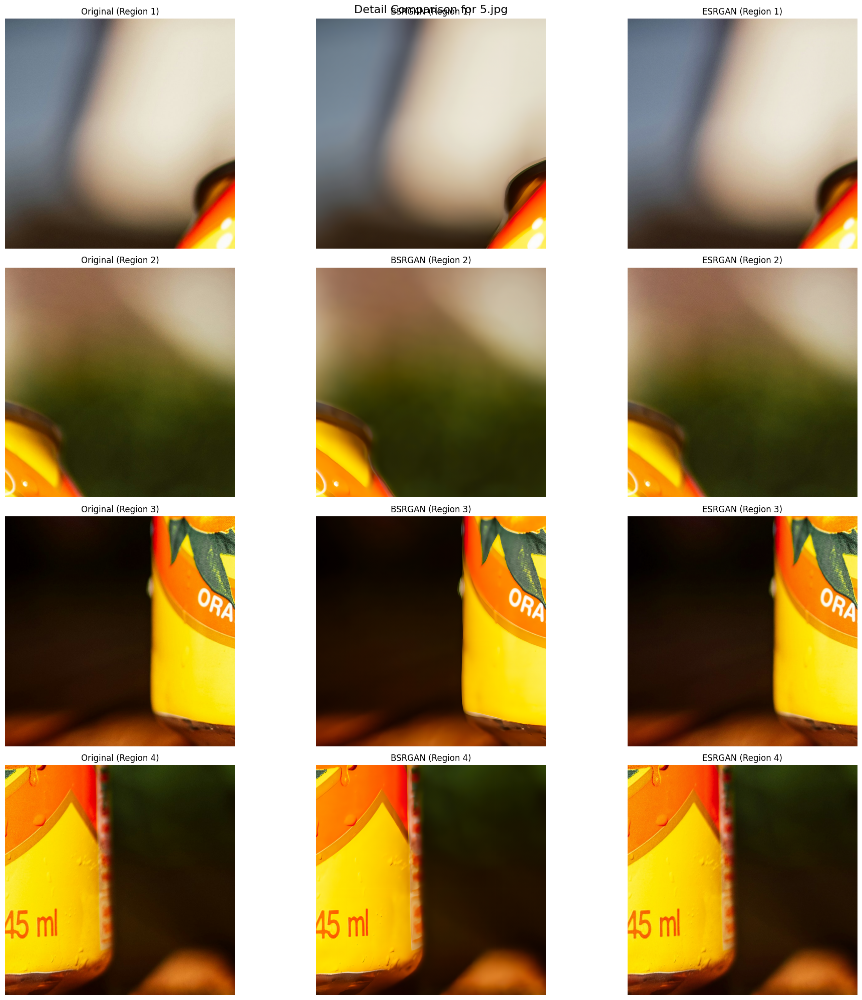

In [27]:
compare_detail_crops("5.jpg")

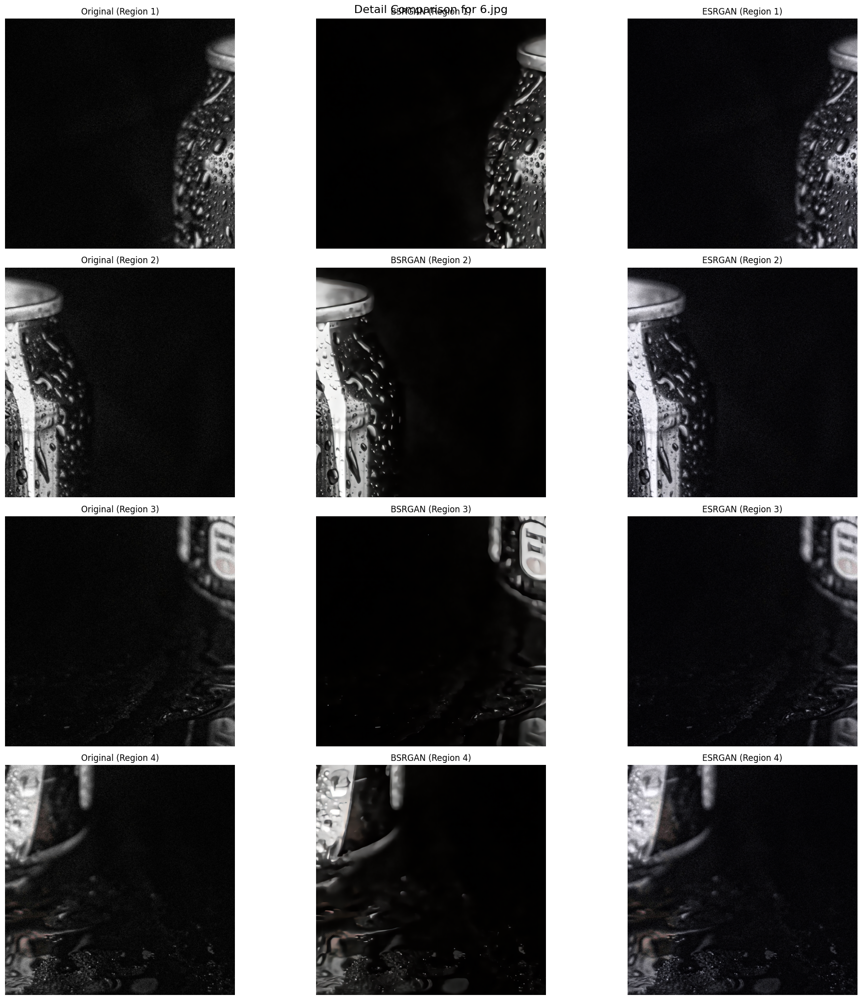

In [28]:
compare_detail_crops("6.jpg")